# Sisteme de ayuda en la predicción de enfermedades durante consulta de optometría

In [1]:
import pandas as pd
import xlrd
import numpy as np

In [2]:
atencion = pd.read_excel('ATENCIONES_D.xlsx',sheet_name='Hoja1',header = 1)
inscripcion = pd.read_excel('INSCRIPCIONES_D.xlsx',sheet_name='INSCRITOS')

In [3]:
inscripcion.head()

,COMUNA,Ficho_Inscripcion,Fecha_inscrip,Dire_com,Tip_Doc,ID,Fechanac,Edad,Genero,Barrio,...,etnia,Exam_ojos,Usa_Gafas,Tiem_gafas,Glaucoma,Enfermedad,Descripcion,SISBEN,Grupo Edad,COD_BARRIO
0,70,1,43577,CASA DE GOBIERNO ALTAVISTA,CC,22023886,1959-04-17,60.0,M,ALTAVISTA,...,Ninguna de las anteriores,Mas de 2 años,Si,Mas de 2 años,Si,G,TENGO UNA BOLA EN EL PARPADO SUPERIOR IZQUIERD...,Si,MAYOR DE 60,7084
1,70,2,43577,CASA DE GOBIERNO ALTAVISTA,CC,3566898,1953-03-21,66.0,H,LA ESPERANZA,...,Ninguna de las anteriores,Mas de 2 años,NaN,NaN,NaN,NaN,NaN,NaN,MAYOR DE 60,7083
2,70,3,43577,CASA DE GOBIERNO ALTAVISTA,CC,3651220,1954-08-24,64.0,H,EL CONSEJO,...,Ninguna de las anteriores,Mas de 2 años,Si,Mas de 2 años,NaN,D,ME ARDEN Y NO PUEDO VER,Si,MAYOR DE 60,7005
3,70,4,43577,CASA DE GOBIERNO ALTAVISTA,CC,70102546,1957-09-03,61.0,H,NaN,...,Ninguna de las anteriores,Mas de 2 años,Si,Mas de 2 años,No,NaN,"NO VEO, SE ME NUBLAN LOS OJOS Y ME ARDEN",No,MAYOR DE 60,7087
4,70,5,43577,CASA DE GOBIERNO ALTAVISTA,CC,32400950,1942-10-06,76.0,M,NaN,...,Ninguna de las anteriores,Mas de 2 años,Si,Mas de 2 años,No,H,NaN,Si,MAYOR DE 60,7087


In [4]:
atencion.head()

,FICHO,CONSECUTIVO,ID,EDAD,GRUPO EDAD,OPTOMETRA,FECHA ATENCION\nCONSULTA,CONSULTA,ESTUCHE Y PAÑO,MONTURA,...,7\nLentes bifocales flat top policarbonato,8\nLentes bifocales invisible CR-39 terminados,9\nLentes bifocales invisible CR-39 tallados,10\nLentes bifocales invisible policarbonato,11\nLentes progresivos en CR-39,12\nLentes progresivos en policarbonato,TOTAL LENTES UNITARIOS,REFERENCIA MONTURA,VALOR USUARIO,Unnamed: 38
0,1,44402.0,4.277358e+07,51.0,ENTRE 18 Y 59,2,2019-05-13,1.0,1.0,1.0,...,0,0,0,0,0,0,2.0,DG5676,99020,70
1,2,44351.0,1.152223e+09,20.0,ENTRE 18 Y 59,1,2019-05-13,1.0,1.0,1.0,...,0,0,0,0,0,0,2.0,ERA2183,110254,70
2,3,44451.0,4.320362e+07,39.0,ENTRE 18 Y 59,3,2019-05-13,1.0,1.0,1.0,...,0,0,0,0,0,0,2.0,FLA1530,105112,70
3,4,44403.0,4.355560e+07,59.0,ENTRE 18 Y 59,2,2019-05-13,1.0,1.0,1.0,...,0,0,0,0,0,2,2.0,WF135,235478,70
4,5,44352.0,1.037618e+09,27.0,ENTRE 18 Y 59,1,2019-05-13,1.0,1.0,1.0,...,0,0,0,0,0,0,2.0,DA668,99020,70


In [5]:
optometria = atencion.merge(inscripcion, left_on = 'ID', right_on = 'ID', how = 'left')
print(optometria.shape)
print(optometria.columns)

(8151, 61)
Index(['FICHO', 'CONSECUTIVO', 'ID', 'EDAD', 'GRUPO EDAD', 'OPTOMETRA',
       'FECHA ATENCION\nCONSULTA', 'CONSULTA', 'ESTUCHE Y PAÑO', 'MONTURA',
       'TIPO MONTURA', 'MONTURA \nAIRE\nÓ\nCOMPLETA', 'DX\nPPAL\nCIE 10',
       'ESFERA-OD', 'CILINDRO-OD', 'EJE-OD', 'ADD-OD', 'TIPO LENTE-OD',
       'ESFERA-OI', 'CILINDRO-OI', 'EJE-OI', 'ADD-OI', 'TIPO LENTE-OI',
       '1\nLentes monofocales en CR-39 terminados',
       '2\nLentes monofocales en CR-39 tallados',
       '3\nLentes monofocales en policarbonato terminados\n',
       '4\nLentes monofocales en policarbonato tallado',
       '5\nLentes bifocales flat top CR-39 terminados',
       '6\nLentes bifocales flat top CR-39 tallados',
       '7\nLentes bifocales flat top policarbonato',
       '8\nLentes bifocales invisible CR-39 terminados',
       '9\nLentes bifocales invisible CR-39 tallados',
       '10\nLentes bifocales invisible policarbonato',
       '11\nLentes progresivos en CR-39',
       '12\nLentes progresivos

In [6]:
columnas = ['EDAD','CONSULTA','ESTUCHE Y PAÑO','MONTURA', 'DX\nPPAL\nCIE 10','ESFERA-OD','CILINDRO-OD','EJE-OD','ADD-OD','TIPO LENTE-OD','ESFERA-OI','CILINDRO-OI','EJE-OI','ADD-OI','TIPO LENTE-OI','Genero','Glaucoma','Enfermedad', 'ocupacion','Dir_Res','poblacion','etnia','Exam_ojos','Usa_Gafas','Tiem_gafas','Descripcion','SISBEN','COD_BARRIO']

Eliminacion de acuerdo al juicio del experto

In [7]:
optometria_dep = optometria[columnas]

In [8]:
#Imprimimos los valores únicos de todas las columnas para encontrar registros con problemas 
for (columnName,columnData) in optometria_dep.iteritems():
    print(columnName)
    print(optometria_dep[columnName].unique())

EDAD
[51. 20. 39. 59. 27. 50. 28. 21. 52. 41. 53. 40. 34. 38. 48. 44. 54. 56.
 72. 58. 84. 49. 46. 76. 61. 60. 74. 63. 67. 73. 55. 19. 43. 47. 57. 66.
 71. 62. 77. 24. 33. 22. 78. 30. 37. 31. 29. 36. 26. 35. 18. 23. 45. 64.
 65. 69. 81. 82. 68. 42. nan 70. 79. 75. 89. 32. 25. 85. 83. 90.  0. 87.
 80. 86. 99. 96. 88. 95. 93. 92. 17.]
CONSULTA
[ 1. nan]
ESTUCHE Y PAÑO
[ 1. nan]
MONTURA
[ 1. nan]
DX
PPAL
CIE 10
['H524' 'H522' 'H521' 'H520' 'H500' 'H525' 'Z010' nan 'H269' 'h524' 'z010'
 ' H524' 'H268' 'h522' 'H52' 'H110' 'ZO10' 'H264' 'h520' 'H101' 'H22'
 'H50' 'H420' 'H502' 'H24' 'H54' 'H21' 'DA151']
ESFERA-OD
[2 'N' -1 1.5 -0.25 2.75 -1.25 3.5 -0.5 0.25 1 0.75 3.25 0.5 1.25 -1.5 -3
 2.5 1.75 -2.75 3 -0.75 -6 -2.5 -2 2.25 -8.5 -3.5 4 '-0.25' -7 nan 4.5
 -0.258 -7.5 5.5 -4.5 3.75 5 -1.75 -4.25 -3.25 -7.25 -4 -11 -4.75 4.25
 -6.5 -2.25 6 -8 -9 -5 'NO APLICA ' -5.5 6.5 -12 -14 7 6.75 -6.75 10 -11.5
 9 2.501 -3.75 -6.25 'BALANCE ' 0.501 '-15.00' -18 '-0.50' '-8.00' '-7.00'
 ' N' '-1.00' -8.75

In [9]:
#Count Nans
def count_Nans(df):
    for (name,data) in df.iteritems():
        count = df[(df[name].isna()==True)].shape[0]
        print(name + ":" + str(count))
        
count_Nans(optometria_dep)

EDAD:2
CONSULTA:2
ESTUCHE Y PAÑO:359
MONTURA:359
DX
PPAL
CIE 10:3
ESFERA-OD:5
CILINDRO-OD:3522
EJE-OD:3529
ADD-OD:2900
TIPO LENTE-OD:2
ESFERA-OI:7
CILINDRO-OI:3485
EJE-OI:3507
ADD-OI:2906
TIPO LENTE-OI:2
Genero:316
Glaucoma:1259
Enfermedad:5759
ocupacion:516
Dir_Res:318
poblacion:991
etnia:739
Exam_ojos:554
Usa_Gafas:743
Tiem_gafas:2582
Descripcion:992
SISBEN:550
COD_BARRIO:329


In [10]:
def count_invalids(df,invalids,columnName):
    for i in invalids:
        count = df[(df[columnName].map(lambda x: x in invalids))].shape[0]
        print (i + ":" + str(count))
        
def remove_invalids(df,invalids,name):
    return df[(df[name].map(lambda x: x not in invalids))]

def df_replace(df,value,campo):
    return df[campo].map(lambda x: 0 if str(x).upper().find(value) != -1 else x)

In [11]:
#Se hacen los ajustes que para que los datos similares se escriban de la misma manera
#1. Se remueve los registros sin edad
optometria_dep = optometria_dep[(optometria_dep['EDAD'].isna()==False)]

#2. Se convierten los valores NA de consulta en 0
optometria_dep['CONSULTA']= np.where(optometria_dep['CONSULTA']==1,True,False)

#3. Se convierten los valores del campo "ESTUCHE Y PAÑO" en False
optometria_dep['ESTUCHE Y PAÑO']= np.where(optometria_dep['ESTUCHE Y PAÑO']==1,True,False)

#4. Se convierten los valores del campo "ESTUCHE Y PAÑO" en False
optometria_dep['MONTURA']= np.where(optometria_dep['MONTURA']==1,True,False)

#5.Se ajusta el valor de diagnostico
optometria_dep = optometria_dep.rename(columns={'DX\nPPAL\nCIE 10':'DX PPAL CIE'})
optometria_dep['DX PPAL CIE'] = optometria_dep['DX PPAL CIE'].map(lambda x: str(x).upper().replace(" ","").replace("ZO10","Z010"))
optometria_dep = optometria_dep[(optometria_dep['DX PPAL CIE'].isna()==False)]

In [12]:
#7. Se ajusta otros campos
invalidas = ['NO APLICA','NO APLICA ', 'BALANCE ','BALANCE', 'IMPRACTICABLE ','IMPRACTICABLE']
campos = ['ESFERA-OD','CILINDRO-OD','ESFERA-OI','CILINDRO-OI','EJE-OD','EJE-OI','ADD-OD','ADD-OI']

In [13]:
for campo in campos:
    print(campo)
    count_invalids(optometria_dep,invalidas,campo)
    optometria_dep=remove_invalids(optometria_dep,invalidas,campo)
    optometria_dep[campo]=df_replace(optometria_dep,'N',campo)
    optometria_dep[campo]=pd.to_numeric(optometria_dep[campo],errors='coerce')
    optometria_dep[campo]= np.where(optometria_dep[campo].isnull(),0,optometria_dep[campo])

ESFERA-OD
NO APLICA:5
NO APLICA :5
BALANCE :5
BALANCE:5
IMPRACTICABLE :5
IMPRACTICABLE:5
CILINDRO-OD
NO APLICA:5
NO APLICA :5
BALANCE :5
BALANCE:5
IMPRACTICABLE :5
IMPRACTICABLE:5
ESFERA-OI
NO APLICA:0
NO APLICA :0
BALANCE :0
BALANCE:0
IMPRACTICABLE :0
IMPRACTICABLE:0
CILINDRO-OI
NO APLICA:9
NO APLICA :9
BALANCE :9
BALANCE:9
IMPRACTICABLE :9
IMPRACTICABLE:9
EJE-OD
NO APLICA:0
NO APLICA :0
BALANCE :0
BALANCE:0
IMPRACTICABLE :0
IMPRACTICABLE:0
EJE-OI
NO APLICA:0
NO APLICA :0
BALANCE :0
BALANCE:0
IMPRACTICABLE :0
IMPRACTICABLE:0
ADD-OD
NO APLICA:0
NO APLICA :0
BALANCE :0
BALANCE:0
IMPRACTICABLE :0
IMPRACTICABLE:0
ADD-OI
NO APLICA:0
NO APLICA :0
BALANCE :0
BALANCE:0
IMPRACTICABLE :0
IMPRACTICABLE:0


In [14]:
#8. Correcciones para genero
def genero(input):
    s = str(input)
    if ( s.find('H') != -1):
        return 'Hombre'
    elif (s.find('M')!= -1):
        return 'Mujer'
    else:
        return 'Otro'
    
optometria_dep['Genero'] = optometria_dep['Genero'].map(genero)

In [15]:
#9. Corrección Glaucomo
optometria_dep['Glaucoma'] = optometria_dep['Glaucoma'].map(lambda x: str(x).upper)

In [16]:
#10. Corrección enfermedad
optometria_dep['Enfermedad H'] = optometria_dep['Enfermedad'].map(lambda x: str(x).upper().find('H')!=-1)
optometria_dep['Enfermedad D'] = optometria_dep['Enfermedad'].map(lambda x: str(x).upper().find('D')!=-1)
optometria_dep['Enfermedad G'] = optometria_dep['Enfermedad'].map(lambda x: str(x).upper().find('G')!=-1)

#Drop enfermedad
optometria_dep = optometria_dep.drop('Enfermedad', axis = 1)

In [17]:
#11. Corrección ocupación
def ocupacion(x):
    s  =str(x).upper();
    if s == 'OFICIOS DEL HOGAR ':
        return 'OFICIOS DEL HOGAR'
    elif s == 'TRABAJADOR ':
        return 'TRABAJADOR'
    elif s == 'PENSIONADO' or s == 'PENSIONADA' or s == 'JUBILADO':
        return 'JUBILADO'
    elif pd.isnull(x):
        return 'NO APLICA'
    else:
        return (s)

optometria_dep['ocupacion'] = optometria_dep['ocupacion'].map(ocupacion)

In [18]:
def etnia(x):
    s  =str(x).upper();
    if s == 'NEGRO O AFRODECENDIENTE' or s == 'NEGRO AFRODECENDIENTE' or s =='NEGRO O AFRODECENDIENTE' :
        return 'NEGRO O AFRODESCENDIENTE'
    elif pd.isnull(x):
        return 'NINGUNA DE LAS ANTERIORES'
    elif s == 'NO APLICA':
        return 'NINGUNA DE LAS ANTERIORES'
    else:
        return (s)
    
optometria_dep['etnia'] = optometria_dep['etnia'].map(etnia)

In [19]:
def exam_ojos(x):
    s  =str(x).upper();
    if s == 'Menos de 1 año'.upper() or s == 'Menos de 1 año '.upper():
        return 'MENOS DE 1 AÑO'
    elif pd.isnull(x):
        return 'NO APLICA'
    else:
        return (s)
    
optometria_dep['Exam_ojos'] = optometria_dep['Exam_ojos'].map(exam_ojos)

In [20]:
def usa_gafas(x):
    s  =str(x).upper();
    if pd.isnull(x):
        return 'NO'
    else:
        return s;
    
optometria_dep['Usa_Gafas'] = optometria_dep['Usa_Gafas'].map(usa_gafas)
optometria_dep['SISBEN'] = optometria_dep['SISBEN'].map(usa_gafas)

In [21]:
def tiem_gafas(x):
    s  =str(x).upper();
    if s == 'MAS DE 2 AÑOS'.upper() or s == 'MAS DE  2 AÑOS'.upper():
        return 'MAS DE 2 AÑOS'
    elif pd.isnull(x):
        return 'NO APLICA'
    else:
        return (s)
optometria_dep['Tiem_gafas'] = optometria_dep['Tiem_gafas'].map(tiem_gafas)

In [22]:
#Se verifican los valores luego de la limpieza
#Imprimimos los valores únicos de todas las columnas para encontrar registros con problemas 
for (columnName,columnData) in optometria_dep.iteritems():
    print(columnName)
    print(optometria_dep[columnName].unique())

EDAD
[51. 20. 39. 59. 27. 50. 28. 21. 52. 41. 53. 40. 34. 38. 48. 44. 54. 56.
 72. 58. 84. 49. 46. 76. 61. 60. 74. 63. 67. 73. 55. 19. 43. 47. 57. 66.
 71. 62. 77. 24. 33. 22. 78. 30. 37. 31. 29. 36. 26. 35. 18. 23. 45. 64.
 65. 69. 81. 82. 68. 42. 70. 79. 75. 89. 32. 25. 85. 83. 90.  0. 87. 80.
 86. 99. 96. 88. 93. 92. 17.]
CONSULTA
[ True]
ESTUCHE Y PAÑO
[ True False]
MONTURA
[ True False]
DX PPAL CIE
['H524' 'H522' 'H521' 'H520' 'H500' 'H525' 'Z010' 'H269' 'H268' 'H52'
 'H110' 'H101' 'H22' 'H50' 'H420' 'H502' 'H24' 'H54' 'H21' 'DA151']
ESFERA-OD
[  2.      0.     -1.      1.5    -0.25    2.75   -1.25    3.5    -0.5
   0.25    1.      0.75    3.25    0.5     1.25   -1.5    -3.      2.5
   1.75   -2.75    3.     -0.75   -6.     -2.5    -2.      2.25   -8.5
  -3.5     4.     -7.      4.5    -0.258  -7.5     5.5    -4.5     3.75
   5.     -1.75   -4.25   -3.25   -7.25   -4.    -11.     -4.75    4.25
  -6.5    -2.25    6.     -8.     -9.     -5.     -5.5     6.5   -12.
 -14.      7.     

In [23]:
optometria_dep.dtypes

EDAD              float64
CONSULTA             bool
ESTUCHE Y PAÑO       bool
MONTURA              bool
DX PPAL CIE        object
ESFERA-OD         float64
CILINDRO-OD       float64
EJE-OD            float64
ADD-OD            float64
TIPO LENTE-OD      object
ESFERA-OI         float64
CILINDRO-OI       float64
EJE-OI            float64
ADD-OI            float64
TIPO LENTE-OI      object
Genero             object
Glaucoma           object
ocupacion          object
Dir_Res            object
poblacion          object
etnia              object
Exam_ojos          object
Usa_Gafas          object
Tiem_gafas         object
Descripcion        object
SISBEN             object
COD_BARRIO         object
Enfermedad H         bool
Enfermedad D         bool
Enfermedad G         bool
dtype: object

A continuación se imprimen los valores del campo enfermedad con el fin de identificar irregularidades en dicho campo.

In [24]:
numeric_pd = optometria_dep[['EDAD','ESFERA-OD','CILINDRO-OD','EJE-OD','ADD-OD','ESFERA-OI','CILINDRO-OI','EJE-OI','ADD-OI','DX PPAL CIE']]

In [25]:
import seaborn as sns
sns.pairplot(numeric_pd,hue='DX PPAL CIE')

/Users/SFIGUEROA90/anaconda3/lib/python3.7/site-packages/numpy/core/_methods.py:217: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
/Users/SFIGUEROA90/anaconda3/lib/python3.7/site-packages/numpy/core/_methods.py:209: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/SFIGUEROA90/anaconda3/lib/python3.7/site-packages/statsmodels/nonparametric/kde.py:487: RuntimeWarning: invalid value encountered in true_divide
  binned = fast_linbin(X, a, b, gridsize) / (delta * nobs)
/Users/SFIGUEROA90/anaconda3/lib/python3.7/site-packages/statsmodels/nonparametric/kdetools.py:34: RuntimeWarning: invalid value encountered in double_scalars
  FAC1 = 2*(np.pi*bw/RANGE)**2


In [26]:
optometria_dep['Astigmatismo'] = np.where(optometria_dep['DX PPAL CIE'] == 'H522',True,False)

In [27]:
numeric_pd = optometria_dep[['EDAD','ESFERA-OD','CILINDRO-OD','EJE-OD','ADD-OD','ESFERA-OI','CILINDRO-OI','EJE-OI','ADD-OI','Astigmatismo']]


In [28]:
numeric_cols = ['EDAD','ESFERA-OD','CILINDRO-OD','EJE-OD','ADD-OD','ESFERA-OI','CILINDRO-OI','EJE-OI','ADD-OI']

In [29]:
numeric_pd['Astigmatismo'].describe()

count      8130
unique        2
top       False
freq       5368
Name: Astigmatismo, dtype: object

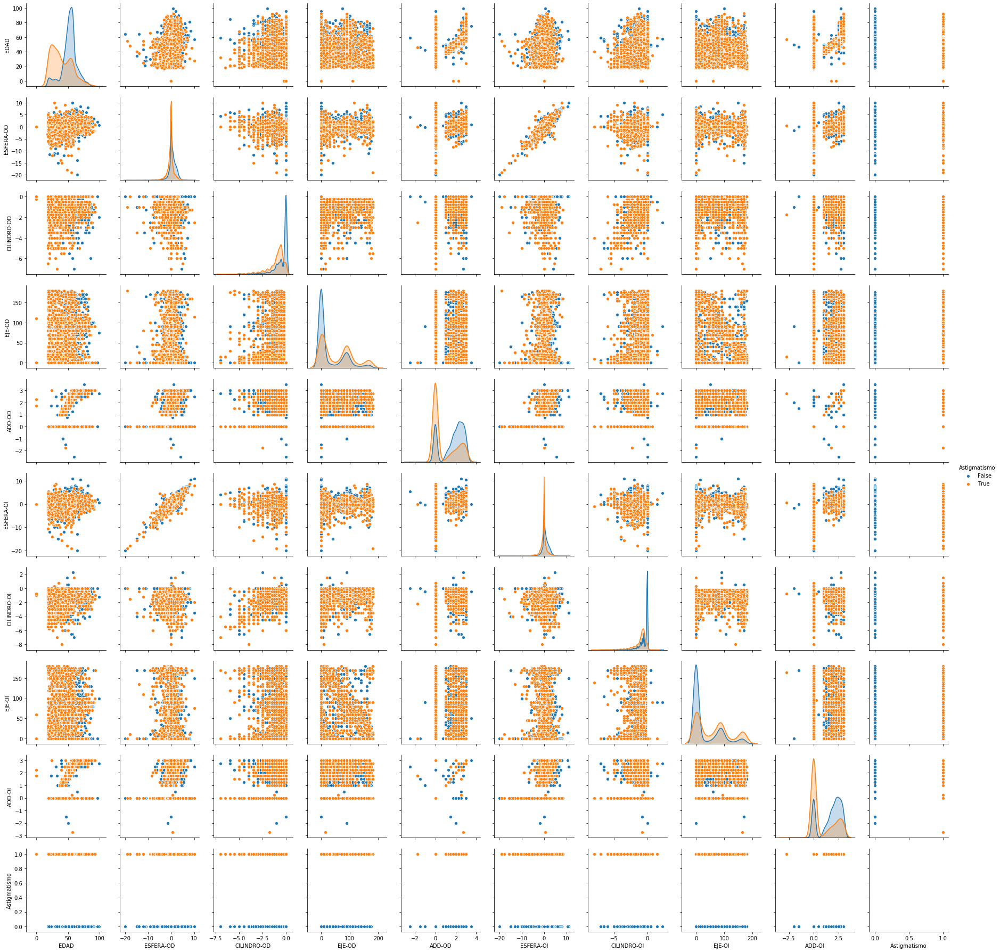

In [30]:
sns.pairplot(numeric_pd,hue='Astigmatismo')

In [31]:
ddx = pd.get_dummies(optometria_dep['DX PPAL CIE'],prefix ="",prefix_sep = "")

In [32]:
numeric_cols = ['EDAD','ESFERA-OD','CILINDRO-OD','EJE-OD','ADD-OD','ESFERA-OI','CILINDRO-OI','EJE-OI','ADD-OI']

/Users/SFIGUEROA90/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


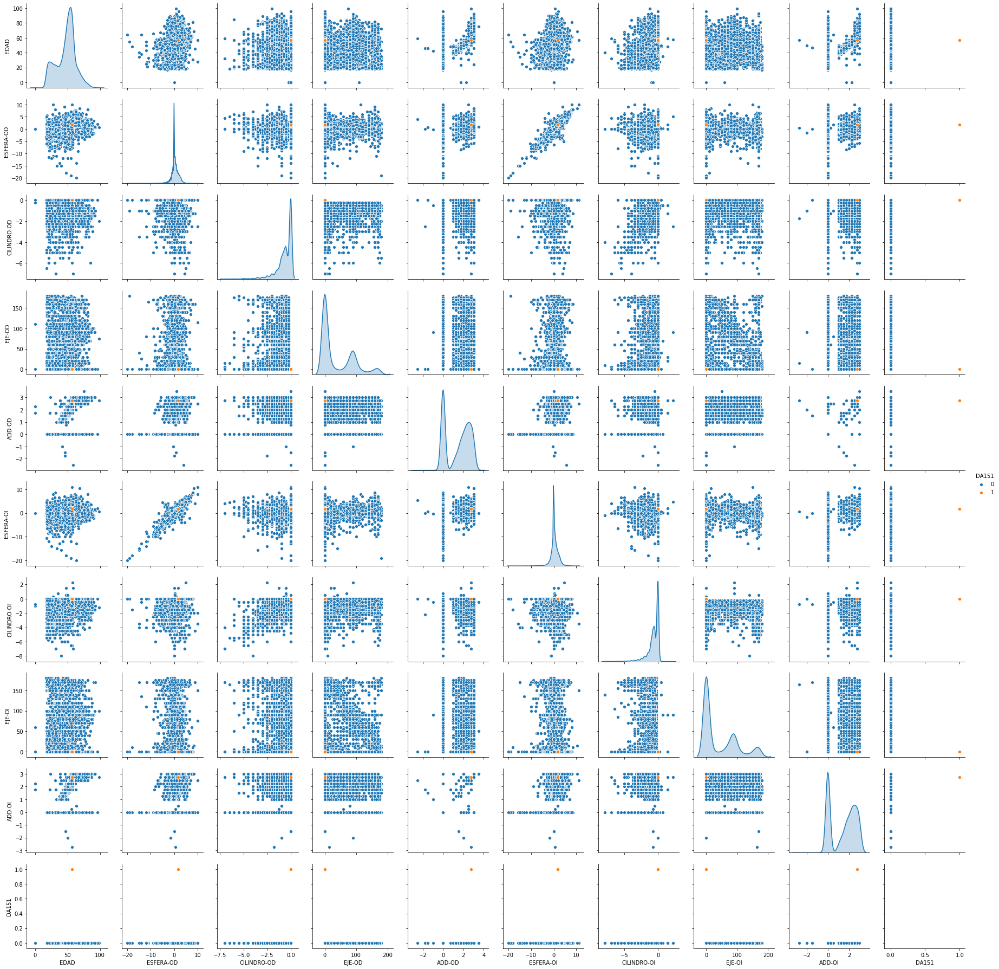

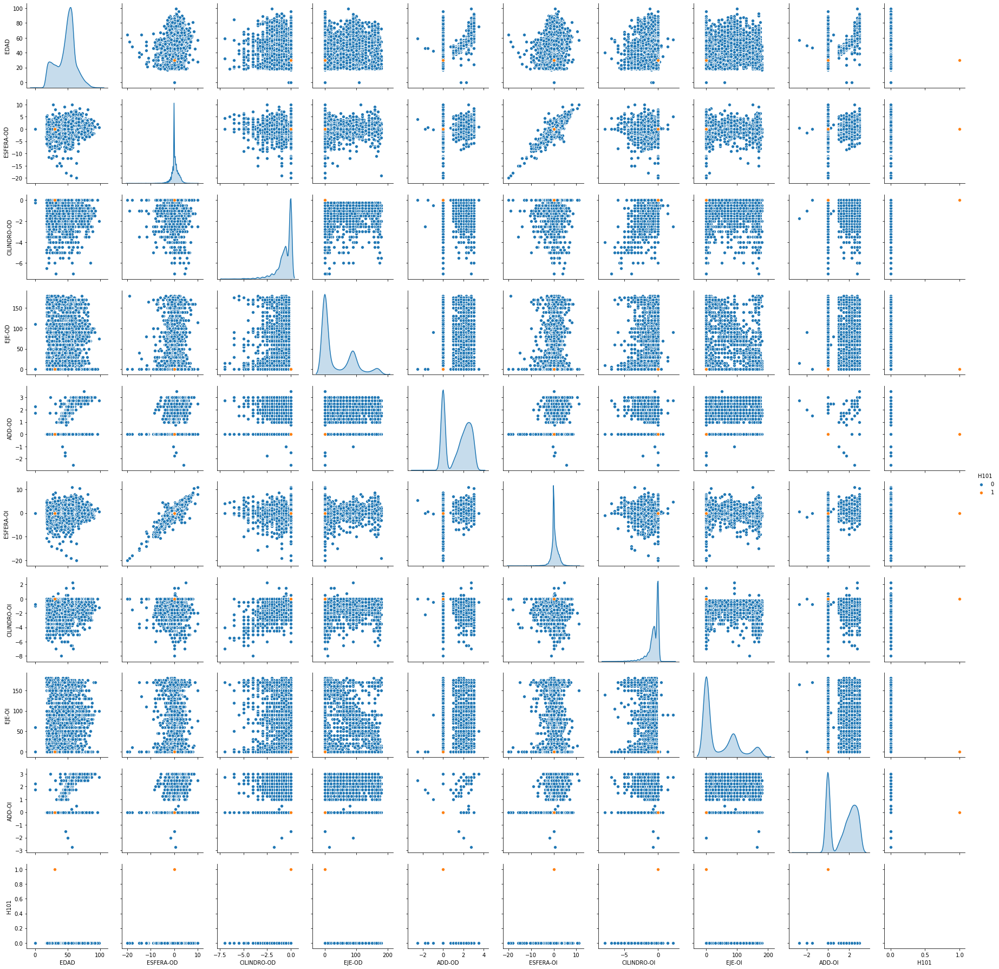

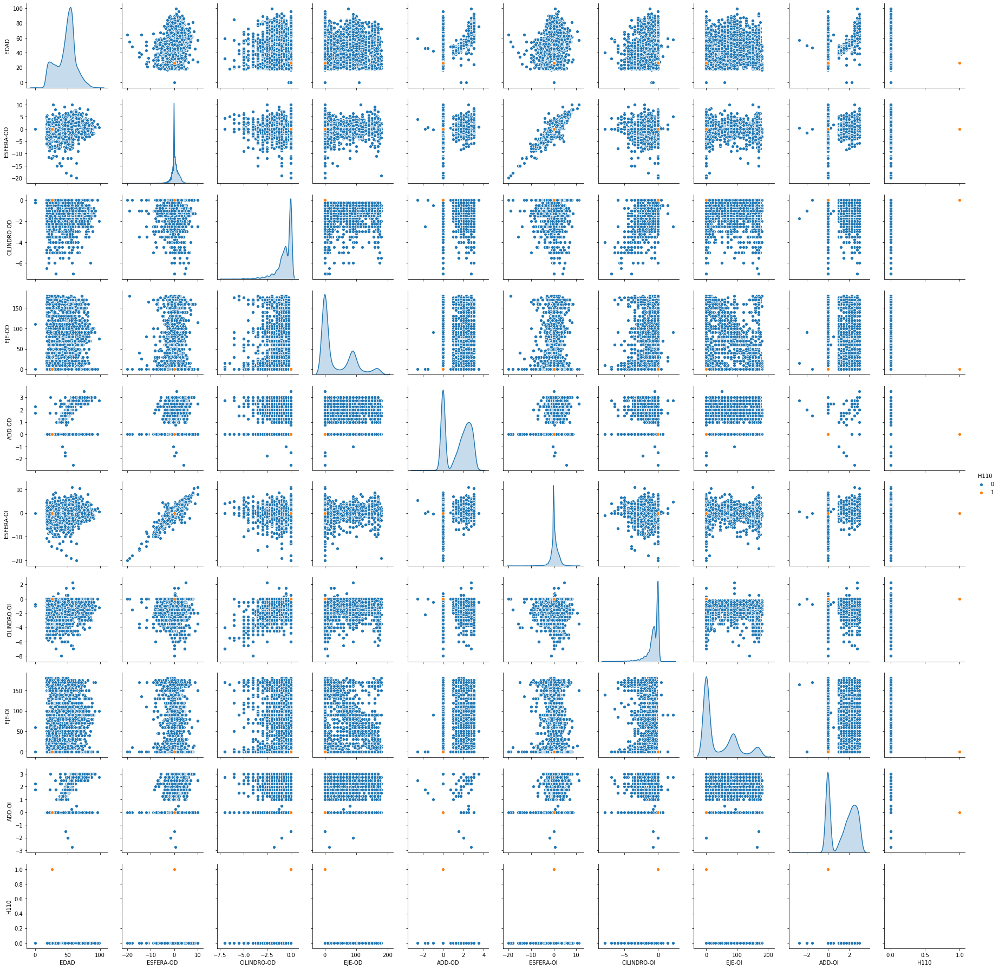

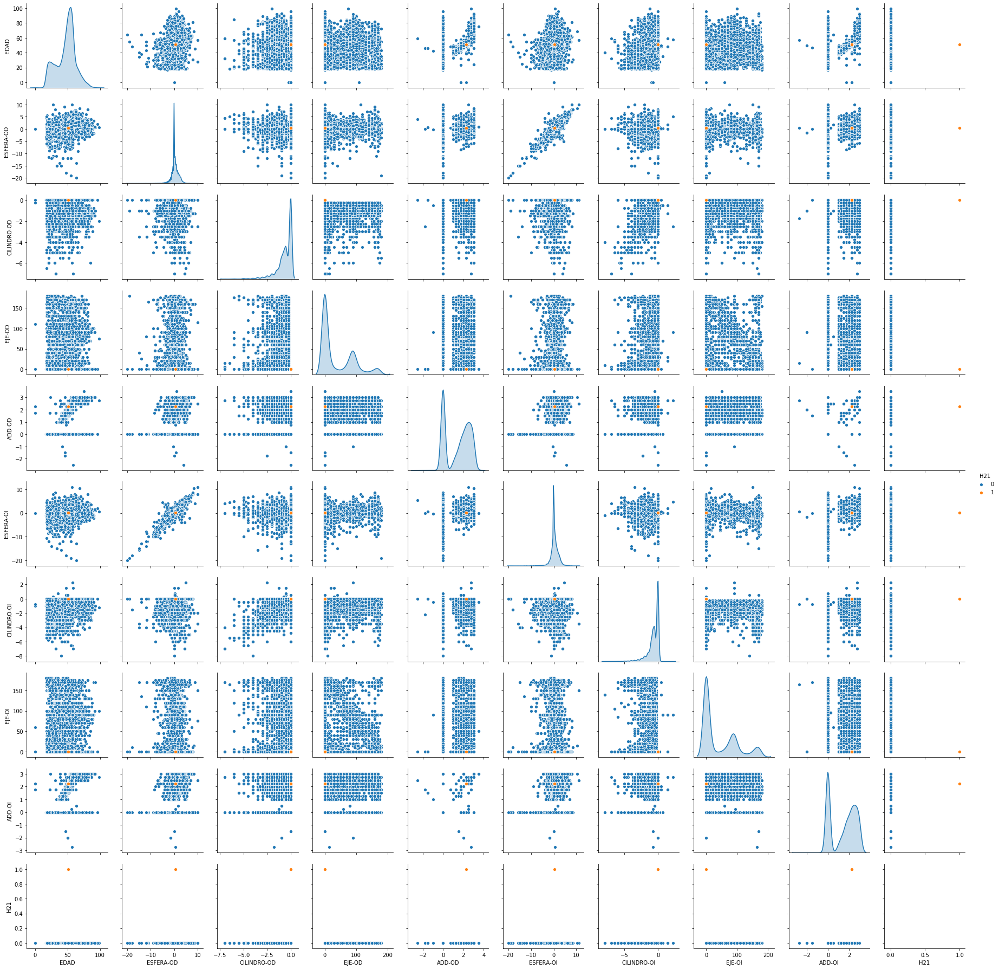

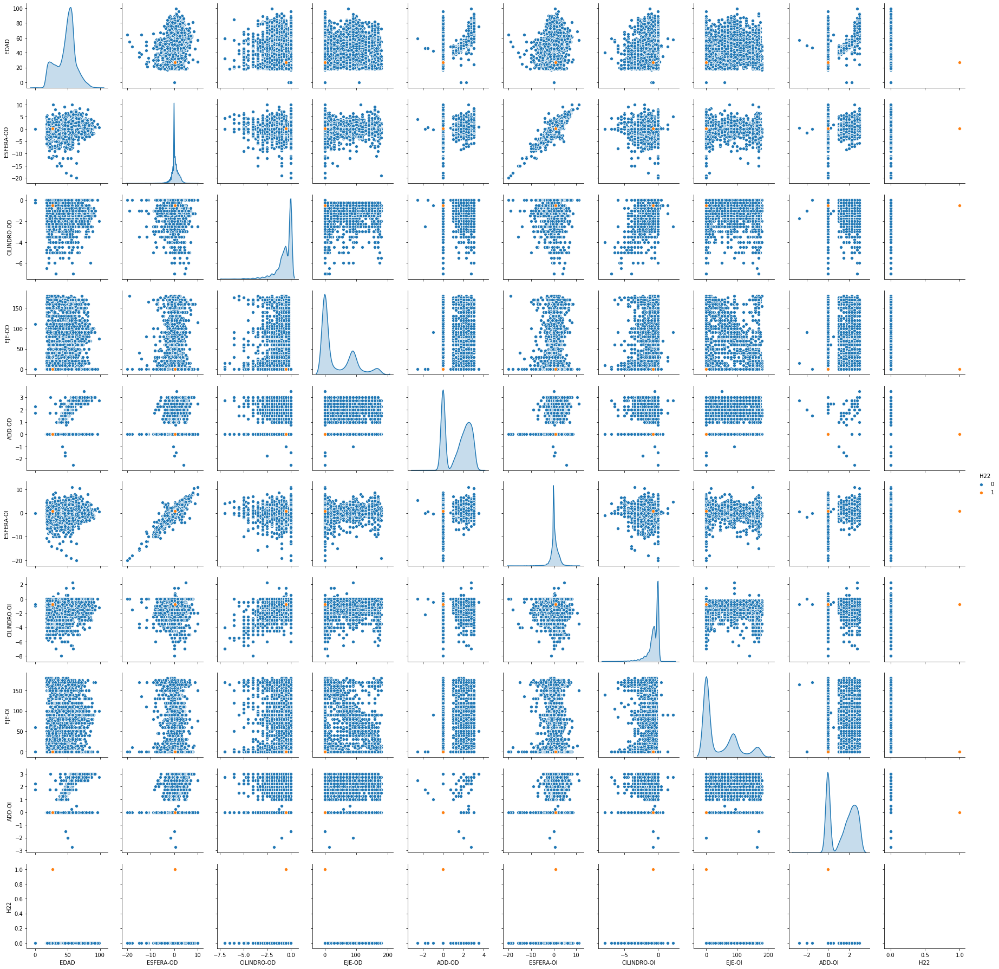

...

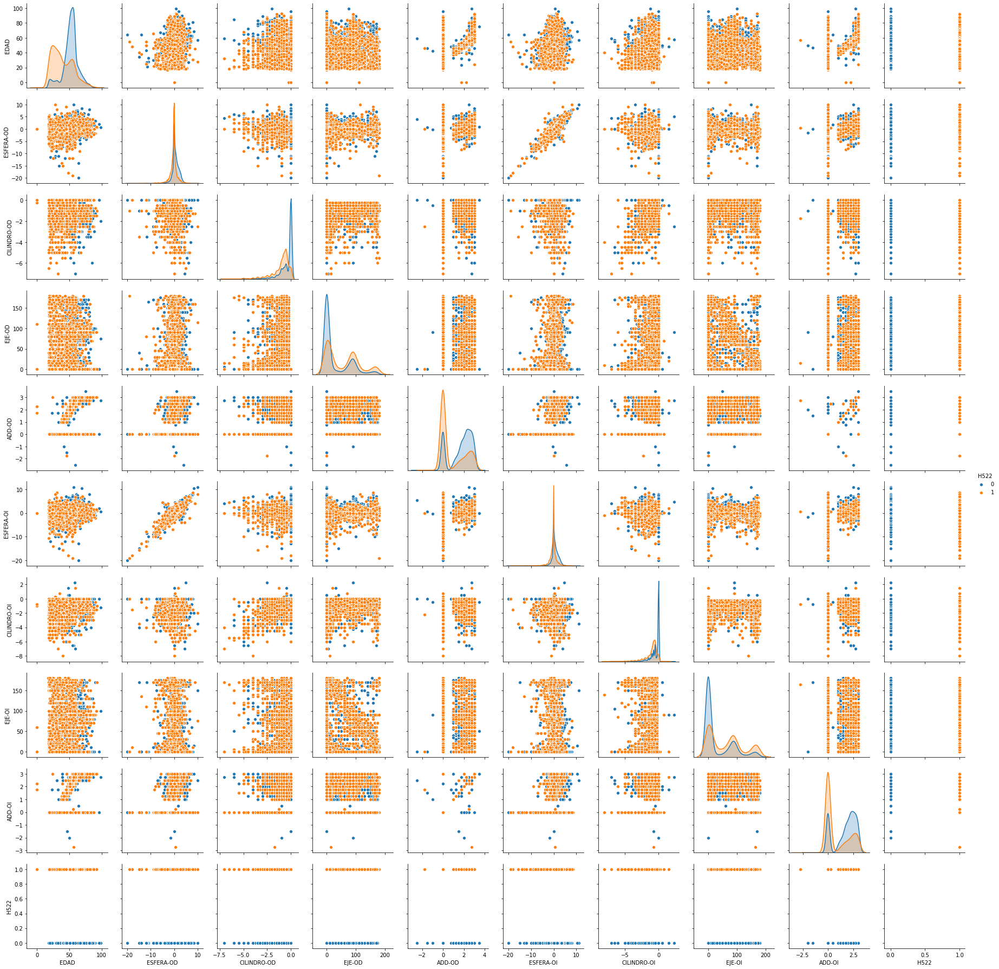

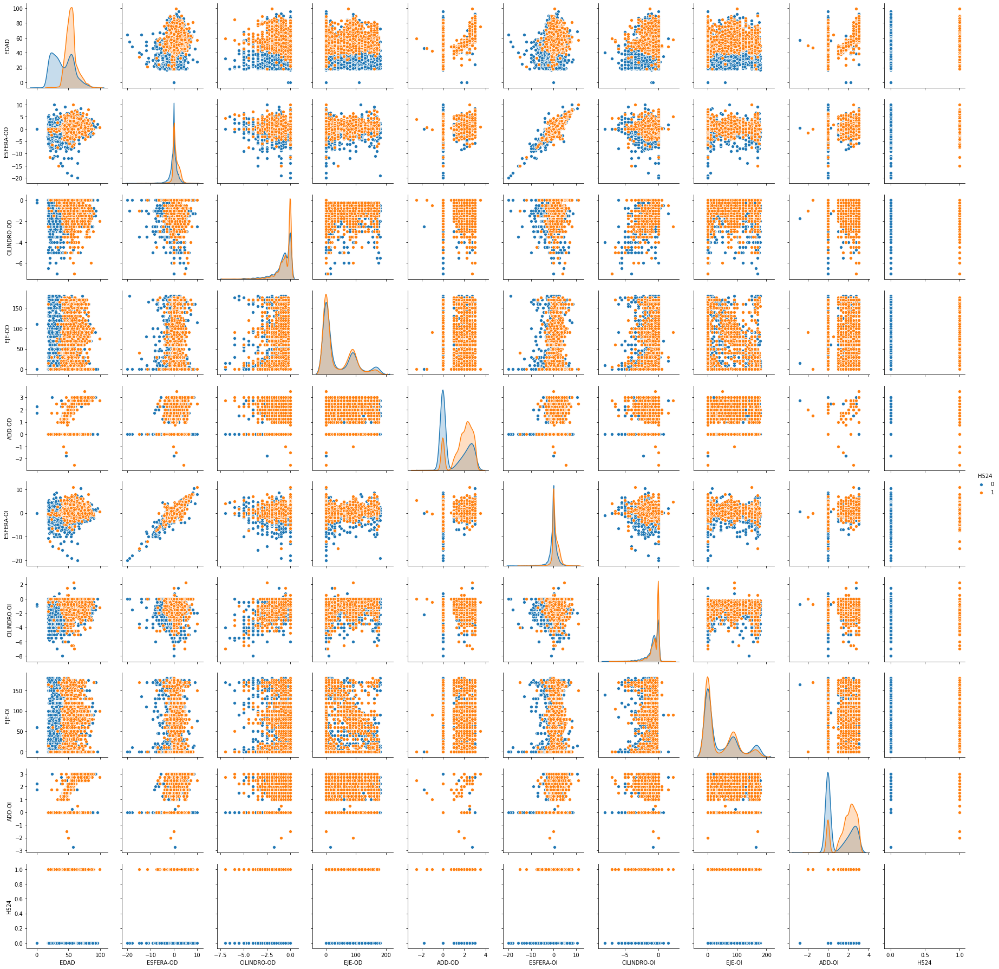

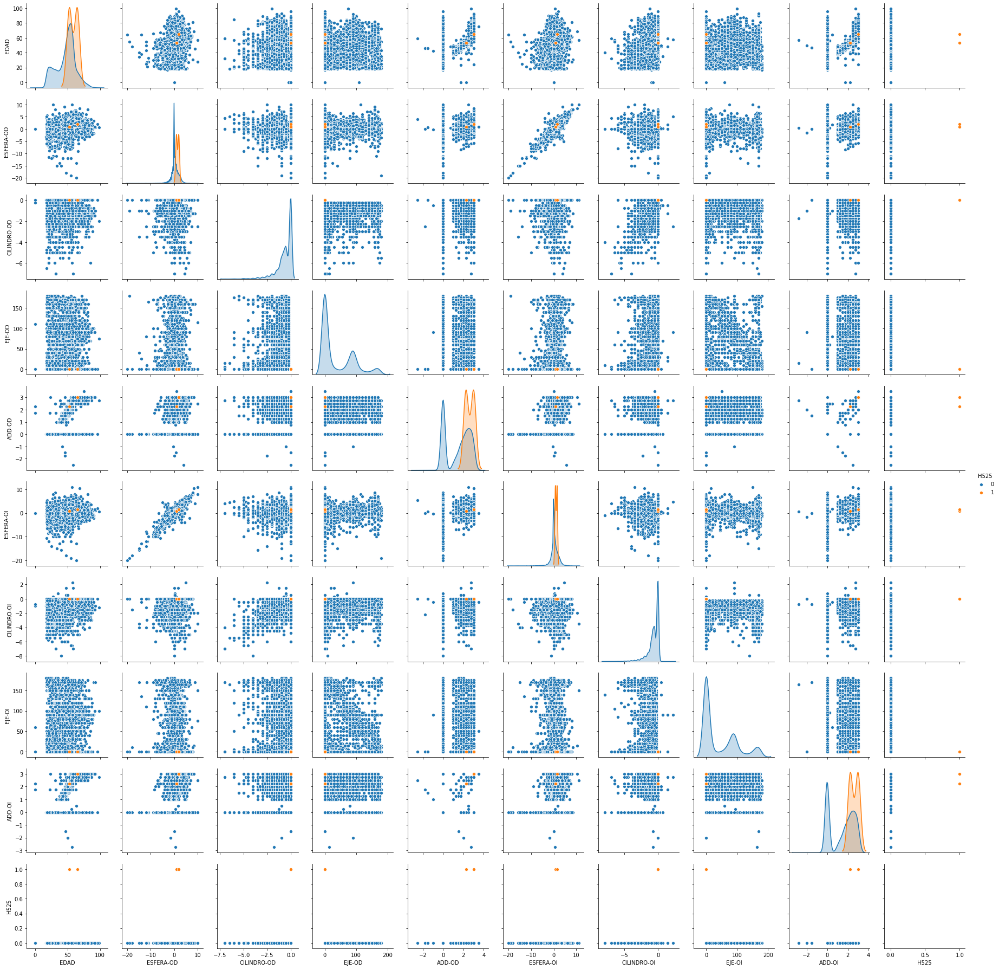

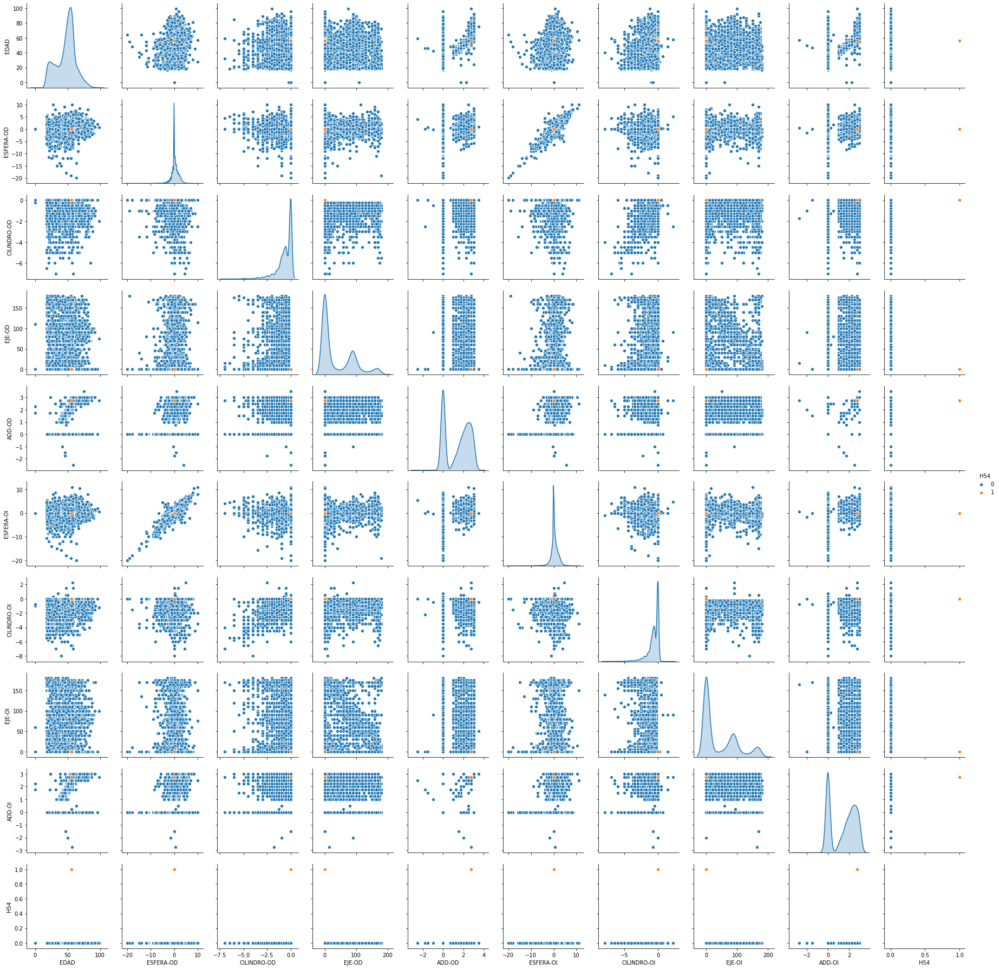

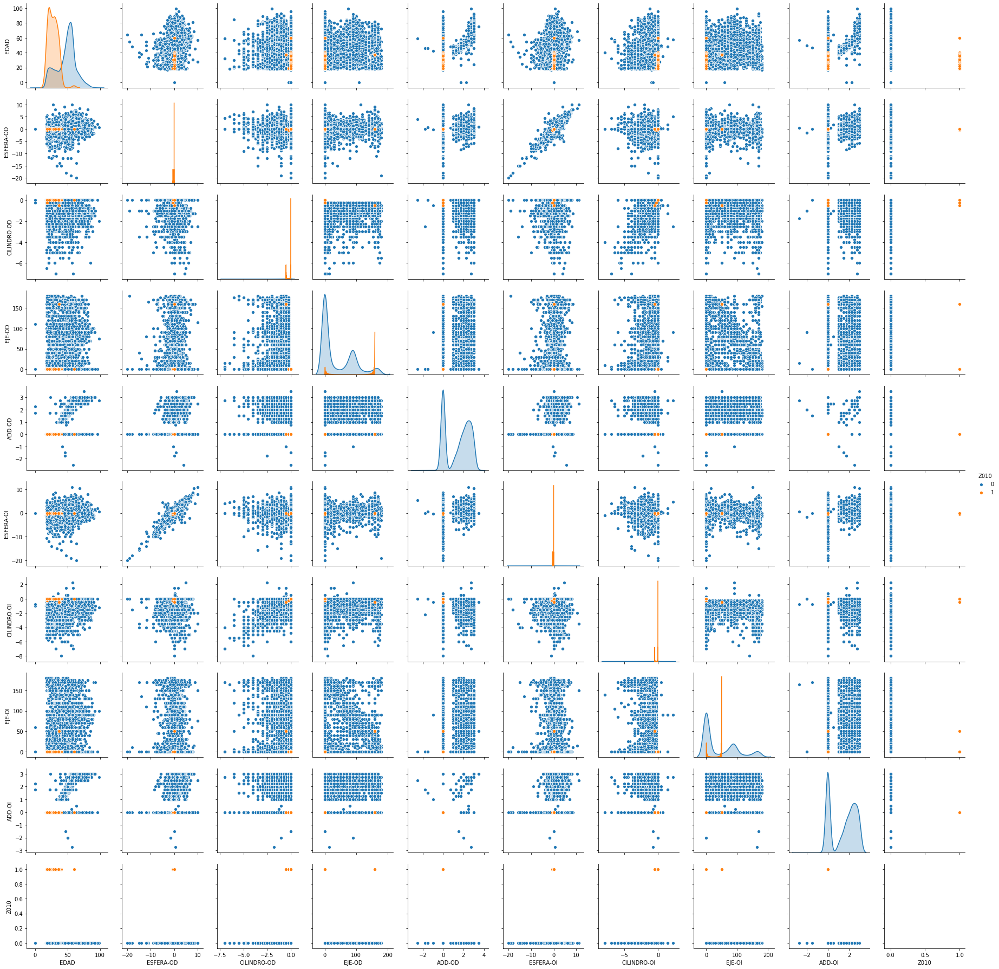

In [33]:

for col in ddx.columns:
    pd_numeric = optometria_dep[numeric_cols]
    pd_numeric[col]=ddx[col]
    sns.pairplot(pd_numeric,hue = col)

In [34]:
optometria_dep['Hipertension'] = optometria_dep['Enfermedad'].map(lambda x: str(x).upper().find('H')!=-1)
optometria_dep['Diabetes'] = optometria_dep['Enfermedad'].map(lambda x: str(x).upper().find('D')!=-1)
optometria_dep['Glaucoma'] = optometria_dep['Enfermedad'].map(lambda x: str(x).upper().find('G')!=-1)

KeyError: 'Enfermedad'

In [ ]:
#Por facilidad se crea un campo gafas
optometria_dep.dtypes

## Conversion de Variables

In [ ]:
# Se revisa el contenido de todas las columnas
for (columnName, columnData) in optometria_dep.iteritems():
    print(columnName)
    print(columnData.unique())

In [ ]:
#Rename column
optometria_dep = optometria_dep.rename(columns={'DX\nPPAL\nCIE 10':'DX PPAL CIE'})
optometria_dep['DX PPAL CIE'].map(lambda x: str(x).upper()).unique()

In [ ]:
#Se debe notar que existen dos columnas con el campo usa gafas, una tomada e la inscripción y otra en la atención
ddx = pd.get_dummies(optometria_dep['DX PPAL CIE'],prefix ="",prefix_sep = "")
optometria_dep['Usa_Gafas_I']=optometria_dep['Usa_Gafas'].iloc[:,0]
optometria_dep['Usa_Gafas_A']=optometria_dep['Usa_Gafas'].iloc[:,1]

In [ ]:
#Se procede a revisar los valores
print('ESFERA-OD')
print(optometria_dep['ESFERA-OD'].unique())
print('ESFERA-OI')
print(optometria_dep['ESFERA-OI'].unique())
print('CILINDRO-OD')
print(optometria_dep['CILINDRO-OD'].unique())
print('CILINDRO-OI')
print(optometria_dep['CILINDRO-OI'].unique())
print('EJE-OD')
print(optometria_dep['EJE-OD'].unique())
print('EJE-OI')
print(optometria_dep['EJE-OI'].unique())
print('ADD-OD')
print(optometria_dep['EJE-OD'].unique())
print('ADD-OI')
print(optometria_dep['EJE-OI'].unique())
print('TIPO LENTE-OD')
print(optometria_dep['TIPO LENTE-OD'].unique())
print('TIPO LENTE-OI')
print(optometria_dep['TIPO LENTE-OI'].unique())
print('Genero')
print(optometria_dep['Genero'].unique())
print('Usa_Gafas_I')
print(optometria_dep['Usa_Gafas_I'].unique())
print('ocupacion')
print(optometria_dep['ocupacion'].unique())
print('poblacion')
print(optometria_dep['poblacion'].unique())
print('etnia')
print(optometria_dep['etnia'].unique())
print('Exam_ojos')
print(optometria_dep['Exam_ojos'].unique())
print('SISBEN')
print(optometria_dep['SISBEN'].unique())
print('Tiem_gafas')
print(optometria_dep['Tiem_gafas'].unique())
print('COD_BARRIO')
print(optometria_dep['COD_BARRIO'].unique())


'ESFERA-OD', numéricas tipo flotante
'CILINDRO-OD', numéricas tipo flotante
'EJE-OD', numéricas tipo flotante
'ADD-OD', numéricas tipo flotante
'TIPO LENTE-OD', numéricas tipo flotante
'ESFERA-OI', numéricas tipo flotante
'CILINDRO-OI', numéricas tipo flotante
'EJE-OI', numéricas tipo flotante
'ADD-OI', numéricas tipo flotante 
'TIPO LENTE-OI', categoría
'Genero', categorica
'Usa_Gafas', categórica
'Glaucoma', categórica
'Enfermedad', categórica
'ocupacion',categorica
'Dir_Res', texto
'poblacion', texto
'etnia', texto
'Exam_ojos', categórica
'Usa_Gafas', categórica
'Tiem_gafas', categórica
'Descripcion', texto
'SISBEN', categórica
'COD_BARRIO', texto
'Astigmatismo', categórica


In [ ]:
#Imprimimos los valores no numericos
#print('ESFERA-OD No numeric')
#optometria_dep['ESFERA-O'][optometria_dep['ESFERA-OD']
#print(optometria_dep['ESFERA-OI'][(optometria_dep['ESFERA-OI'].map(lambda x:str(x).isnumeric == True))])
#print(optometria_dep['CILINDRO-OD'][optometria_dep['CILINDRO-OD'].map(lambda x:str(x).isnumeric)==False])
#print(optometria_dep['EJE-OD'][optometria_dep['EJE-OD'].map(lambda x:str(x).isnumeric)==False])
#print(optometria_dep['ADD-OD'][optometria_dep['EJE-OD'].map(lambda x:str(x).isnumeric)==False])
#print(optometria_dep['TIPO LENTE-OD'][optometria_dep['TIPO LENTE-OD'].map(lambda x:str(x).isnumeric)==False])
#print(optometria_dep['ESFERA-OI'][optometria_dep['ESFERA-OI'].map(lambda x:str(x).isnumeric) == False])
#print(optometria_dep['CILINDRO-OI'][optometria_dep['CILINDRO-OI'].map(lambda x:str(x).isnumeric)==False])
#print(optometria_dep['EJE-OI'][optometria_dep['EJE-OI'].map(lambda x:str(x).isnumeric)==False])
#print(optometria_dep['ADD-OI'][optometria_dep['ADD-OI'].map(lambda x:str(x).isnumeric)==False])
#print(optometria_dep['TIPO LENTE-OI'][optometria_dep['TIPO LENTE-OI'].map(lambda x:str(x).isnumeric)==False])

